# Basic Technical Analysis Part 1
## Introduction
This information sets out to detail a wide selection of components used in the technical analysis of options. With this there is an explanation of what each component is and how it is used.

In this first part, there is a brief overview of how basic statistical and computational analysis of stock share price can be computed using python. For visualisations I have chosen to plot using the python library plotly (for interaction purposes) but I have also included matplotlib and seaborn as standards. 


# 1. Import Libraries

In [1]:
import yfinance as yf
import pandas as pd
import numpy as np

import datetime
from datetime import date, timedelta

import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.style as style
from matplotlib.dates import date2num, DateFormatter, WeekdayLocator,\
    DayLocator, MONDAY
import matplotlib.patches as mpatches

import plotly.express as px
import plotly.subplots as sp
import plotly.graph_objects as go

import seaborn as sns

import mplfinance as mpf
from mplfinance.original_flavor import candlestick_ohlc

from scipy import stats
from scipy.stats import zscore
from statsmodels.tsa.stattools import adfuller
from statsmodels.tsa.stattools import coint

import warnings
warnings.filterwarnings('ignore')

import yfinance as yf

%matplotlib inline

# 2. Dow Jones Index Analysis
## 2.1 Obtaining all Dow Jones Index Tickers

Get all the tickers from the table in this Wikepedia Page
(https://en.wikipedia.org/wiki/Dow_Jones_Industrial_Average)


In [2]:
df_dow_jones = pd.read_html("https://en.wikipedia.org/wiki/Dow_Jones_Industrial_Average")[1]
df_dow_jones

,Company,Exchange,Symbol,Industry,Date added,Notes,Index weighting
0,3M,NYSE,MMM,Conglomerate,1976-08-09,As Minnesota Mining and Manufacturing,2.41%
1,American Express,NYSE,AXP,Financial services,1982-08-30,NaN,3.02%
2,Amgen,NASDAQ,AMGN,Biopharmaceutical,2020-08-31,NaN,5.48%
3,Apple,NASDAQ,AAPL,Information technology,2015-03-19,NaN,2.84%
4,Boeing,NYSE,BA,Aerospace and defense,1987-03-12,NaN,3.36%
5,Caterpillar,NYSE,CAT,Construction and mining,1991-05-06,NaN,4.52%
6,Chevron,NYSE,CVX,Petroleum industry,2008-02-19,Also 1930-07-18 to 1999-11-01,3.50%
7,Cisco,NASDAQ,CSCO,Information technology,2009-06-08,NaN,0.96%
8,Coca-Cola,NYSE,KO,Drink industry,1987-03-12,Also 1932-05-26 to 1935-11-20,1.22%
9,Disney,NYSE,DIS,Broadcasting and entertainment,1991-05-06,NaN,1.89%


In [3]:
tickers = df_dow_jones['Symbol'].tolist()
tickers


['MMM',
 'AXP',
 'AMGN',
 'AAPL',
 'BA',
 'CAT',
 'CVX',
 'CSCO',
 'KO',
 'DIS',
 'DOW',
 'GS',
 'HD',
 'HON',
 'IBM',
 'INTC',
 'JNJ',
 'JPM',
 'MCD',
 'MRK',
 'MSFT',
 'NKE',
 'PG',
 'CRM',
 'TRV',
 'UNH',
 'VZ',
 'V',
 'WBA',
 'WMT']

In [4]:
dow_jones_stock = yf.download(tickers, start=datetime.datetime(2010,1,1), end=datetime.datetime(2023,1,1), group_by='tickers')
 

[*********************100%***********************]  30 of 30 completed


In [5]:
dow_jones_stock

CRM                                                  \
                  Open        High         Low       Close   Adj Close   
Date                                                                     
2010-01-04   18.652500   18.882500   18.547501   18.705000   18.705000   
2010-01-05   18.612499   18.750000   18.200001   18.625000   18.625000   
2010-01-06   18.687500   18.750000   18.495001   18.592501   18.592501   
2010-01-07   18.629999   18.737499   18.385000   18.510000   18.510000   
2010-01-08   18.517500   18.587500   18.315001   18.537500   18.537500   
...                ...         ...         ...         ...         ...   
2022-12-23  128.729996  129.860001  127.589996  129.440002  129.440002   
2022-12-27  128.559998  131.750000  127.650002  130.660004  130.660004   
2022-12-28  129.710007  131.139999  128.169998  128.470001  128.470001   
2022-12-29  129.699997  132.949997  129.500000  132.539993  132.539993   
2022-12-30  130.610001  132.639999  130.360001  132.589996  132.589996   

                            TRV                                      ...  \
             Volume        Open        High         Low       Close  ...   
Date                                                                 ...   
2010-01-04  7906000   50.150002   50.439999   49.660000   49.810001  ...   
2010-01-05  7942400   49.630001   49.689999   48.520000   48.630001  ...   
2010-01-06  5122400   48.259998   48.389999   47.349998   47.939999  ...   
2010-01-07  4840000   47.820000   48.849998   47.820000   48.630001  ...   
2010-01-08  5510400   48.650002   48.759998   48.070000   48.560001  ...   
...             ...         ...         ...         ...         ...  ...   
2022-12-23  5821300  187.639999  189.910004  186.869995  189.479996  ...   
2022-12-27  8300800  189.940002  191.149994  188.970001  190.479996  ...   
2022-12-28  6249800  190.960007  191.220001  188.110001  188.130005  ...   
2022-12-29  7628800  188.470001  190.039993  187.960007  189.440002  ...   
2022-12-30  5630200  189.000000  189.380005  186.449997  187.490005  ...   

                   MRK                                           UNH  \
                   Low       Close   Adj Close    Volume        Open   
Date                                                                   
2010-01-04   34.875954   35.314884   22.130056  14563532   31.379999   
2010-01-05   35.238548   35.458015   22.219755  15452550   31.730000   
2010-01-06   35.209923   35.935116   22.518726  15971415   31.600000   
2010-01-07   35.687023   35.992367   22.554607  12488597   31.590000   
2010-01-08   35.715649   35.973282   22.542654  11283921   32.860001   
...                ...         ...         ...       ...         ...   
2022-12-23  110.870003  111.860001  109.603195   4547400  524.099976   
2022-12-27  111.529999  112.120003  109.857948   5125800  533.929993   
2022-12-28  111.059998  111.080002  108.838928   5107800  535.070007   
2022-12-29  110.750000  110.820000  108.584175   4467200  532.539978   
2022-12-30  110.120003  110.949997  108.711548   5498600  530.000000   

                                                                      
                  High         Low       Close   Adj Close    Volume  
Date                                                                  
2010-01-04   31.600000   30.969999   31.530001   25.685118  12199500  
2010-01-05   31.969999   31.280001   31.480000   25.644394  11180700  
2010-01-06   32.060001   31.410000   31.790001   25.896925   9761100  
2010-01-07   33.049999   31.590000   33.009998   26.890766  11789800  
2010-01-08   32.919998   32.340000   32.700001   26.638235   7228700  
...                ...         ...         ...         ...       ...  
2022-12-23  531.309998  522.900024  531.309998  525.215332   1292300  
2022-12-27  535.840027  529.849976  531.989990  525.887573   1596700  
2022-12-28  538.150024  527.729980  528.450012  522.388184   1694200  
2022-12-29  533.679993  528.859985  529.880005  523.8016

In [6]:
dow_jones_stock.describe()

CRM                                                      \
              Open         High          Low        Close    Adj Close   
count  3272.000000  3272.000000  3272.000000  3272.000000  3272.000000   
mean    103.428258   104.728752   102.008559   103.409431   103.409431   
std      71.278581    72.140033    70.263135    71.204781    71.204781   
min      15.522500    15.625000    15.075000    15.520000    15.520000   
25%      42.346874    42.747500    41.862499    42.396875    42.396875   
50%      76.295002    77.185001    75.704998    76.275002    76.275002   
75%     155.057503   157.427498   152.930000   155.182495   155.182495   
max     310.000000   311.750000   307.250000   309.959991   309.959991   

                             TRV                                         ...  \
             Volume         Open         High          Low        Close  ...   
count  3.272000e+03  3272.000000  3272.000000  3272.000000  3272.000000  ...   
mean   6.910582e+06   108.180984   109.038276   107.302534   108.202081  ...   
std    5.048138e+06    36.463231    36.776993    36.112470    36.452082  ...   
min    1.084700e+06    46.240002    47.439999    45.970001    46.799999  ...   
25%    4.056725e+06    80.755001    81.235001    80.067499    80.682503  ...   
50%    5.549200e+06   112.000000   113.025002   111.049999   111.940002  ...   
75%    8.116575e+06   134.482498   135.452503   133.365005   134.514996  ...   
max    6.456280e+07   190.970001   191.220001   188.970001   190.479996  ...   

               MRK                                                  UNH  \
               Low        Close    Adj Close        Volume         Open   
count  3272.000000  3272.000000  3272.000000  3.272000e+03  3272.000000   
mean     57.669752    58.169448    48.176769  1.256821e+07   187.203808   
std      17.693737    17.877426    20.134463  6.640800e+06   144.279622   
min      28.120230    28.444656    19.019562  2.343223e+06    27.889999   
25%      43.349237    43.671277    31.265351  8.670158e+06    59.704999   
50%      55.820610    56.149809    44.000448  1.108190e+07   137.084999   
75%      73.645039    74.341606    67.242409  1.435453e+07   266.529999   
max     111.529999   112.120003   109.857948  1.024973e+08   555.000000   

                                                                         
              High          Low        Close    Adj Close        Volume  
count  3272.000000  3272.000000  3272.000000  3272.000000  3.272000e+03  
mean    189.112173   185.291785   187.264804   175.156348  4.773605e+06  
std     145.796392   142.747582   144.297174   143.141823  3.079094e+06  
min      28.309999    27.129999    27.850000    22.803450  7.140000e+05  
25%      60.380001    58.922501    59.502499    50.469350  2.824250e+06  
50%     137.864998   135.869995   136.904999   123.033031  3.854700e+06  
75%     268.849991   263.709991   266.330002   248.121536  5.724025e+06  
max     558.099976   550.130005   555.150024   547.095337  2.919270e+07  

[8 rows x 180 columns]

In [7]:
dow_jones_stock.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 3272 entries, 2010-01-04 to 2022-12-30
Columns: 180 entries, ('CRM', 'Open') to ('UNH', 'Volume')
dtypes: float64(151), int64(29)
memory usage: 4.5 MB


In [8]:
# The number of rows is an indication of how many trading days are being considered

dow_jones_stock.shape

(3272, 180)

From here on we are only going to conisder the Adjusted Close Price for each company. This is to account for actions such as stock splits and dividends, which gives a reflection with higher accuracy of the true value of the stock. This in turn prevents a clearer more coherent picture of the returns.

In [9]:
adj_close = pd.DataFrame()
for i in tickers:
    adj_close[i] = dow_jones_stock[i]['Adj Close']
    
adj_close

,MMM,AXP,AMGN,AAPL,BA,CAT,CVX,CSCO,KO,DIS,...,MSFT,NKE,PG,CRM,TRV,UNH,VZ,V,WBA,WMT
Date,,,,,,,,,,,,,,,,,,,,,
2010-01-04,55.033218,33.300167,42.146595,6.487533,43.777546,40.732998,45.955879,17.011648,18.645317,27.933922,...,23.522568,13.857417,40.668774,18.705000,35.691940,25.685118,15.677339,19.978863,25.140755,39.871311
2010-01-05,54.688515,33.226955,41.781494,6.498749,45.211349,41.219967,46.281403,16.935860,18.419760,27.864237,...,23.530163,13.912550,40.682076,18.625000,34.846413,25.644394,15.705603,19.749920,24.938545,39.474308
2010-01-06,55.464119,33.764053,41.467510,6.395378,46.582790,41.345211,46.287201,16.825621,18.413219,27.716164,...,23.385765,13.827727,40.489120,18.592501,34.351967,25.896925,15.254006,19.484720,24.749825,39.386078
2010-01-07,55.503891,34.311649,41.087807,6.383555,48.468559,41.512165,46.112812,16.901415,18.367468,27.724873,...,23.142550,13.963449,40.269543,18.510000,34.846413,26.890766,15.163199,19.666063,24.898111,39.408134
2010-01-08,55.895000,34.287140,41.452904,6.425994,48.001011,41.978294,46.194199,16.990976,18.027504,27.768425,...,23.302156,13.935880,40.216293,18.537500,34.796238,26.638235,15.172758,19.720463,24.931807,39.209621
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-12-23,115.073784,144.877274,257.084625,131.299820,189.059998,236.272522,172.482590,46.067886,62.360741,88.010002,...,237.112091,115.152924,149.780884,129.440002,186.249542,525.215332,35.781872,204.643112,36.890579,142.136002
2022-12-27,115.150421,144.256454,256.568359,129.477585,189.399994,239.493484,174.650772,46.116402,62.741817,86.370003,...,235.354095,116.450554,151.086136,130.660004,187.232483,525.887573,36.564396,205.100449,36.584988,142.175537
2022-12-28,113.301804,141.911163,254.649384,125.504539,188.380005,235.789886,172.074234,45.670086,62.116455,84.169998,...,232.940552,113.894913,149.133194,128.470001,184.922562,522.388184,36.154507,203.807953,35.887859,139.684174


### Plotting Adjusted Close Price for all stocks

In [10]:
# Assuming 'adj_close' is your Pandas DataFrame
fig = px.line(adj_close, title='Adjusted Close Price for all stocks')
fig.update_xaxes(title='Year')
fig.update_yaxes(title='Adjusted Close Price (dollar)')

# You can adjust the figure size by setting the width and height
fig.update_layout(width=800, height=400)

fig.show()

This plot shows the absolute adjusted close price for each stock. The relative change of a stock price can be of more use when in a trading scenario. This plot shows UNH to have the greatest price. 

### Calculating the minimum and maximum adjusted close price 

In [11]:
adj_close_min_max = adj_close.apply(lambda x: pd.Series([x.min(), x.max()], index=['min', 'max']))
adj_close_min_max

,MMM,AXP,AMGN,AAPL,BA,CAT,CVX,CSCO,KO,DIS,...,MSFT,NKE,PG,CRM,TRV,UNH,VZ,V,WBA,WMT
min,49.130013,30.069706,35.246281,5.821836,43.777546,35.568455,39.869152,9.529290,16.504202,25.536146,...,17.649082,12.998620,40.056614,15.520000,34.351967,22.803450,13.068329,14.911670,17.909761,35.695946
max,209.277298,193.470078,282.868988,180.190979,430.299988,239.493484,181.433899,60.169132,63.318047,201.910004,...,337.621124,173.653595,158.212952,309.959991,187.232483,547.095337,52.166180,246.838409,73.572899,156.208817


# 2. Data transformation
## 2.1 Consider each stocks' returns since the beginnig of the time frame 

In [12]:
returns_lambda = adj_close.apply(lambda x: x / x[0])
returns_lambda.head()

,MMM,AXP,AMGN,AAPL,BA,CAT,CVX,CSCO,KO,DIS,...,MSFT,NKE,PG,CRM,TRV,UNH,VZ,V,WBA,WMT
Date,,,,,,,,,,,,,,,,,,,,,
2010-01-04,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
2010-01-05,0.993736,0.997801,0.991337,1.001729,1.032752,1.011955,1.007083,0.995545,0.987903,0.997505,...,1.000323,1.003979,1.000327,0.995723,0.976310,0.998414,1.001803,0.988541,0.991957,0.990043
2010-01-06,1.007830,1.013930,0.983888,0.985795,1.064080,1.015030,1.007210,0.989065,0.987552,0.992205,...,0.994184,0.997857,0.995583,0.993986,0.962457,1.008246,0.972997,0.975267,0.984450,0.987830
2010-01-07,1.008553,1.030375,0.974878,0.983973,1.107156,1.019129,1.003415,0.993520,0.985098,0.992516,...,0.983845,1.007652,0.990183,0.989575,0.976310,1.046940,0.967205,0.984343,0.990349,0.988383
2010-01-08,1.015659,1.029639,0.983541,0.990514,1.096476,1.030572,1.005186,0.998785,0.966865,0.994075,...,0.990630,1.005662,0.988874,0.991045,0.974905,1.037108,0.967815,0.987066,0.991689,0.983404


### Plot to show stock returns over the time frame 
This shows how profitable each stock was over a 13 year period

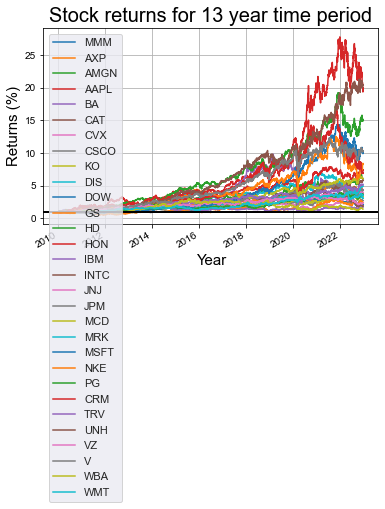

In [13]:
# Plot to show how profitable each stock was throughout the time period

returns_lambda.plot(grid = True).axhline(y = 1, color = "black", lw = 2)
sns.set(rc={'figure.figsize':(15, 9)})
plt.title('Stock returns for 13 year time period', color = 'black', fontsize = 20)
plt.xlabel('Year', color = 'black', fontsize = 15)
plt.ylabel('Returns (%)', color = 'black', fontsize = 15);
plt.legend(loc='upper left')

This plot is a lot more useful as we can see how profitable each stocj was since the beginning of the time period. 

## 2.2 Percentage Change 
Daily percentage change is another transformation we can use. This can be represented by the formula: $increase_{t}$  = $\frac{price_t - price_{t-1}}{price_t}$ 

In [14]:
# Create dataframe to contain returns for each company's stock to plot the change of each stock per day

returns = pd.DataFrame()
for ticker in tickers:
    returns[ticker] = dow_jones_stock[ticker]['Adj Close'].pct_change() * 100

# Clean up the data by dropping the first value which becomes a 'NaN' as there is no price change from the day before.

returns.dropna(inplace=True)
returns.head()

,MMM,AXP,AMGN,AAPL,BA,CAT,CVX,CSCO,KO,DIS,...,MSFT,NKE,PG,CRM,TRV,UNH,VZ,V,WBA,WMT
Date,,,,,,,,,,,,,,,,,,,,,
2019-03-21,0.628906,0.947904,0.402891,3.683042,-0.919831,0.789412,0.938322,1.276747,-0.043885,-1.209194,...,2.297479,1.522679,0.756963,2.103848,2.314778,0.606788,1.075097,1.333323,1.290005,0.425755
2019-03-22,-2.361521,-2.110539,-2.704672,-2.070840,-2.825325,-3.200057,-2.200860,-2.224687,0.922866,-0.395726,...,-2.636857,-6.612888,-0.809808,-3.264449,0.394406,-1.956196,2.521864,-1.752243,-1.871064,-0.787388
2019-03-25,-0.708498,-0.383688,-0.058928,-1.209112,2.288977,1.240675,-0.162485,-0.018978,0.217717,-0.406546,...,0.521179,0.170330,0.295099,-0.383898,0.037079,-0.093075,0.535489,-0.026118,-1.153669,-0.111926
2019-03-26,1.983174,0.421860,0.900369,-1.033154,-0.021594,0.350124,1.009039,0.948245,1.325233,2.180163,...,0.212472,1.275363,1.039615,-0.919947,0.022243,-1.405652,0.915439,1.483363,0.372828,0.152808
2019-03-27,-0.038602,-0.474910,-1.035744,0.899417,1.034073,-0.485449,-1.079525,-0.169068,-0.064337,0.127107,...,-0.966846,-0.347783,-0.116478,-2.685068,1.014962,-0.690257,0.412330,-0.695396,0.500646,-1.128988


In [15]:
# Extract the data for the year 2019
returns_2019 = returns.loc['2019-01-01':'2019-12-31']

# Create a line plot using Plotly Express
fig = px.line(returns_2019, x=returns_2019.index, y=returns_2019.columns, title='Stock Returns for 2019')

# Customize the layout
fig.update_layout(
    xaxis_title='Date',
    yaxis_title='Returns (%)',
    title_font=dict(size=20),
    xaxis=dict(title_font=dict(size=15)),
    yaxis=dict(title_font=dict(size=15)),
)

# Add a horizontal line at y=1 for reference
fig.update_layout(
    shapes=[
        dict(
            type="line",
            x0=returns_2019.index.min(),
            x1=returns_2019.index.max(),
            y0=1,
            y1=1,
            line=dict(color="black", width=2)
        )
    ]
)

fig.show()

The percentage returns plot shows the changes for the year 2019 between each day. More advanced methods consider this when modelling stock behaviour on a defined time period.

## 2.3 Log Differences

An alternative approach to modeling stock growth involves utilizing logarithmic differences. By applying the natural logarithm to stock prices, we can more accurately approximate the true daily returns. This concept can be exemplified using the following formula:

$change_{t}$  = $log (price_{t}) - log (price_{t-1})$ 

Employing logarithms or summarizing changes in terms of continuous compounding provides several advantages over analyzing simple percentage changes. For instance, consider a scenario where your investment portfolio increases by 50% (e.g., from £400 to £600) and then decreases by 50% (e.g., from £600 to £300). In this case, calculating the average percentage return (which would be 0%) fails to convey the fact that you actually ended up 50% below your initial investment.

In contrast, if your portfolio increases logarithmically by approximately 0.4055 and then decreases logarithmically by the same amount, you return precisely to your initial investment. The average log return on your portfolio corresponds exactly to the change in log price between the time of purchase and the time of sale, divided by the number of years you held it.

In [16]:
stock_change = adj_close.apply(lambda x: np.log(x) - np.log(x.shift(1))) # shift moves dates back by 1.

stock_change.head()

# Clean up the data by dropping NaNs

stock_change.dropna(inplace=True)
stock_change.head()

,MMM,AXP,AMGN,AAPL,BA,CAT,CVX,CSCO,KO,DIS,...,MSFT,NKE,PG,CRM,TRV,UNH,VZ,V,WBA,WMT
Date,,,,,,,,,,,,,,,,,,,,,
2019-03-21,0.006269,0.009434,0.004021,0.036168,-0.009241,0.007863,0.009339,0.012687,-0.000439,-0.012166,...,0.022715,0.015112,0.007541,0.020820,0.022884,0.006050,0.010694,0.013245,0.012818,0.004249
2019-03-22,-0.023899,-0.021331,-0.027419,-0.020926,-0.028660,-0.032524,-0.022254,-0.022498,0.009186,-0.003965,...,-0.026722,-0.068417,-0.008131,-0.033189,0.003936,-0.019756,0.024906,-0.017678,-0.018888,-0.007905
2019-03-25,-0.007110,-0.003844,-0.000589,-0.012165,0.022632,0.012330,-0.001626,-0.000190,0.002175,-0.004074,...,0.005198,0.001702,0.002947,-0.003846,0.000371,-0.000931,0.005341,-0.000261,-0.011604,-0.001120
2019-03-26,0.019638,0.004210,0.008963,-0.010385,-0.000216,0.003495,0.010040,0.009438,0.013165,0.021567,...,0.002122,0.012673,0.010342,-0.009242,0.000222,-0.014156,0.009113,0.014725,0.003721,0.001527
2019-03-27,-0.000386,-0.004760,-0.010411,0.008954,0.010288,-0.004866,-0.010854,-0.001692,-0.000644,0.001270,...,-0.009716,-0.003484,-0.001165,-0.027218,0.010098,-0.006926,0.004115,-0.006978,0.004994,-0.011354


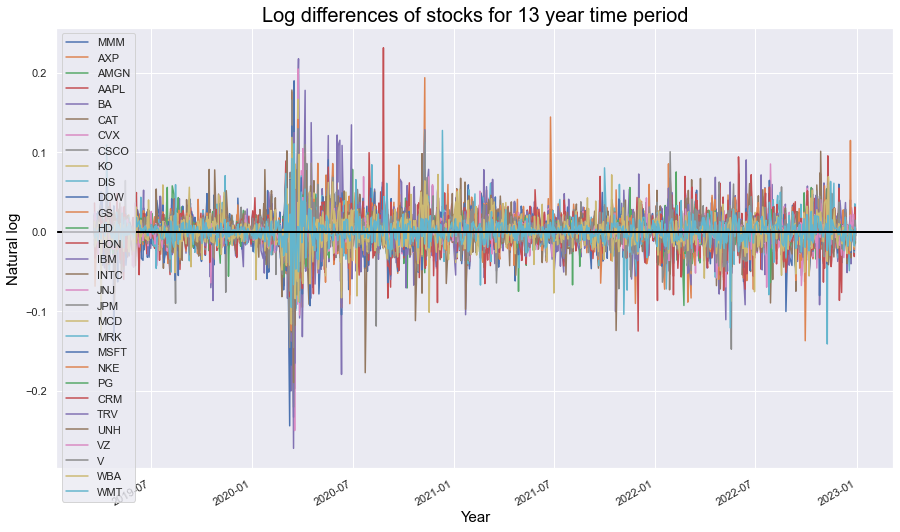

In [17]:
# Plot log differences for 2010-2019

stock_change.plot(grid = True).axhline(y = 0, color = "black", lw = 2)
sns.set(rc={'figure.figsize':(15, 9)})
plt.title('Log differences of stocks for 13 year time period', color = 'black', fontsize = 20)
plt.xlabel('Year', color = 'black', fontsize = 15)
plt.ylabel('Natural log', color = 'black', fontsize = 15);

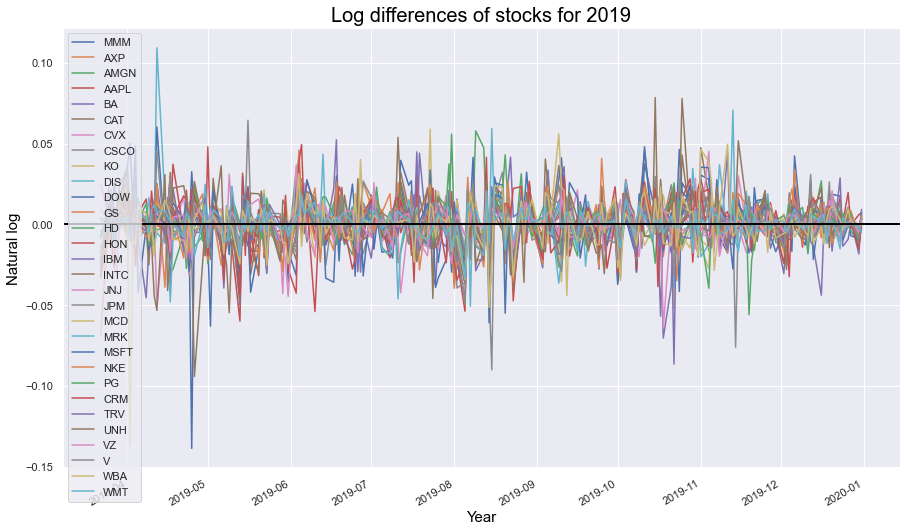

In [18]:
# Plot log differences for 2019

stock_change.loc['2019-01-01':'2019-12-31'][1:].plot(grid = True).axhline(y = 0, color = "black", lw = 2)
sns.set(rc={'figure.figsize':(15, 9)})
plt.title('Log differences of stocks for 2019', color = 'black', fontsize = 20)
plt.xlabel('Year', color = 'black', fontsize = 15)
plt.ylabel('Natural log', color = 'black', fontsize = 15);
plt.legend(loc='upper left')

## 2.4 Annualised Returns
We can calculate the annual percentage rate (APR) by considering annualised returns. 

In [19]:
stock_change_apr = stock_change * 252 * 100    # There are 252 trading days in a year; the 100 converts to percentages
stock_change_apr

,MMM,AXP,AMGN,AAPL,BA,CAT,CVX,CSCO,KO,DIS,...,MSFT,NKE,PG,CRM,TRV,UNH,VZ,V,WBA,WMT
Date,,,,,,,,,,,,,,,,,,,,,
2019-03-21,157.987958,237.746869,101.324643,911.443318,-232.870123,198.150791,235.354748,319.703547,-11.061559,-306.574120,...,572.414042,380.823117,190.036272,524.669825,576.675083,152.448472,269.478465,333.777204,323.002456,107.062400
2019-03-22,-602.242723,-537.548660,-690.964241,-527.330864,-722.233263,-819.599173,-560.811052,-566.951172,231.495718,-99.920886,...,-673.405992,-1724.104181,-204.902318,-836.367977,99.194784,-497.846756,627.628657,-445.479661,-475.974947,-199.207140
2019-03-25,-179.177093,-96.875246,-14.854202,-306.553344,570.319705,310.726532,-40.979415,-4.782787,54.804966,-102.658427,...,130.996007,42.886719,74.255345,-96.928445,9.342113,-23.465824,134.583165,-6.582521,-292.414624,-28.221092
2019-03-26,494.868770,106.085197,225.877670,-261.709135,-5.442382,88.077243,253.003607,237.831995,331.765282,543.497802,...,53.486080,319.359309,260.630552,-232.899603,5.604555,-356.737506,229.641072,371.062254,93.777970,38.478156
2019-03-27,-9.729587,-119.962517,-262.368477,225.639849,259.248323,-122.631061,-273.519287,-42.641223,-16.218065,32.010687,...,-244.830663,-87.794139,-29.369532,-685.887265,254.481259,-174.547782,103.693408,-175.852050,125.848135,-286.123283
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-12-23,-302.324489,294.820169,-127.627420,-70.611444,108.197344,245.979598,767.281137,85.060017,190.250951,386.635703,...,57.066848,-99.517496,71.096853,48.718260,305.069926,200.952359,65.691497,94.449248,124.254473,50.884052
2022-12-27,16.777204,-108.217504,-50.656395,-352.185974,45.277758,341.216037,314.800664,26.524828,153.524684,-474.013098,...,-187.533817,282.384585,218.651806,236.403349,132.644467,32.233725,545.166385,56.254125,-209.619405,7.008475
2022-12-28,-407.841764,-413.063228,-189.189122,-785.379343,-136.078065,-392.744897,-374.532865,-245.074111,-252.434442,-650.207467,...,-259.758851,-559.201805,-327.859169,-425.958974,-312.830710,-168.247613,-284.088934,-159.307076,-484.820885,-445.498193


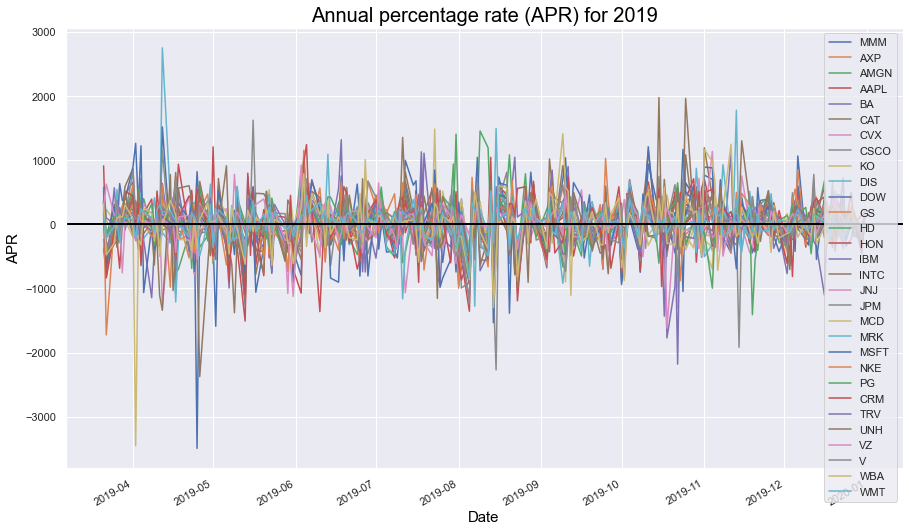

In [20]:
# Plot annualised returns for 2019

stock_change_apr['2019-01-01':'2019-12-31'].plot(grid = True).axhline(y = 0, color = "black", lw = 2)
sns.set(rc={'figure.figsize':(15, 9)})
plt.title('Annual percentage rate (APR) for 2019', color = 'black', fontsize = 20)
plt.xlabel('Date', color = 'black', fontsize = 15)
plt.ylabel('APR', color = 'black', fontsize = 15);

# 3. Calculating Statistical Data for Returns 
## 3.1 Calculating the minimum and maximum returns for 2010-2023

In [21]:
# Date of worst single day returns

returns.idxmin()

MMM    2019-04-25
AXP    2020-03-18
AMGN   2020-03-12
AAPL   2020-03-16
BA     2020-03-16
CAT    2020-03-09
CVX    2020-03-18
CSCO   2022-05-19
KO     2020-03-12
DIS    2022-11-09
DOW    2020-03-09
GS     2020-03-16
HD     2020-03-16
HON    2020-03-12
IBM    2020-03-12
INTC   2020-03-16
JNJ    2020-03-23
JPM    2020-03-16
MCD    2020-03-16
MRK    2021-11-05
MSFT   2020-03-16
NKE    2022-09-30
PG     2020-03-12
CRM    2020-03-16
TRV    2020-03-16
UNH    2020-03-16
VZ     2022-07-22
V      2020-03-16
WBA    2019-04-02
WMT    2022-05-17
dtype: datetime64[ns]

In [22]:
# Date of best single day returns

returns.idxmax()

MMM    2020-03-24
AXP    2020-03-24
AMGN   2020-03-13
AAPL   2020-03-13
BA     2020-03-25
CAT    2020-03-24
CVX    2020-03-24
CSCO   2020-03-13
KO     2020-04-06
DIS    2020-03-24
DOW    2020-03-17
GS     2020-03-13
HD     2020-03-24
HON    2020-03-24
IBM    2020-03-24
INTC   2020-03-13
JNJ    2020-03-30
JPM    2020-03-13
MCD    2020-03-24
MRK    2021-10-01
MSFT   2020-03-13
NKE    2021-06-25
PG     2020-03-13
CRM    2020-08-26
TRV    2020-03-17
UNH    2020-03-24
VZ     2020-03-26
V      2020-03-24
WBA    2020-03-13
WMT    2020-03-17
dtype: datetime64[ns]

There is a common trend amongst the Dow Jones that since they are stocks from the same sector, they have a similarity in there min and max share price. 

## 3.3 Calculating the Mean 
The mean is a statistical indicator that can be used to evaluate the performance f a company's share price over a defined time period. It is the average of the returns, with it also determining the standard deviation and variance which we will touch on later.

In [23]:
returns.mean()

MMM    -0.027745
AXP     0.068697
AMGN    0.058858
AAPL    0.133587
BA     -0.007382
CAT     0.094092
CVX     0.086262
CSCO    0.018697
KO      0.057726
DIS     0.001893
DOW     0.056246
GS      0.092629
HD      0.083617
HON     0.058193
IBM     0.041114
INTC   -0.032310
JNJ     0.045453
JPM     0.062092
MCD     0.058842
MRK     0.060701
MSFT    0.099309
NKE     0.059511
PG      0.061870
CRM     0.010894
TRV     0.065618
UNH     0.104185
VZ     -0.014078
V       0.052936
WBA    -0.014321
WMT     0.055824
dtype: float64

## 3.3 Variance
Variance is a statistical measure that quantifies the extent of deviation from the average or mean in a dataset. It reflects the breadth of the data's range; it is larger when the data covers a wider range and smaller when the range is narrower.

To calculate variance, each data point's difference from the mean is determined, these differences are squared to ensure they are positive, and the sum of these squared differences is divided by the total number of data points in the dataset.

The use of squares in the variance calculation gives more weight to outliers, which are data points that significantly deviate from the mean. This approach also avoids situations where differences above the mean would cancel out differences below it, resulting in a variance value of zero.

Mathematically, variance is represented by the formula σ<sup>2</sup> = $\frac {\sum_{i = 1}^n (x_i - \overline{x})^2}{n}$, where σ<sup>2</sup> denotes the variance, 𝑛 represents the number of data points, 𝑥𝑖 signifies each individual data point, and &xbar; stands for the mean of the dataset.

In [24]:
returns.var()

MMM      3.161760
AXP      6.710323
AMGN     2.797962
AAPL     4.758165
BA      12.281680
CAT      4.470071
CVX      5.964088
CSCO     3.667885
KO       2.083039
DIS      5.095233
DOW      6.750078
GS       4.842342
HD       3.716817
HON      3.445796
IBM      3.209491
INTC     6.141611
JNJ      1.736254
JPM      4.818438
MCD      2.528099
MRK      2.346042
MSFT     4.090280
NKE      4.889820
PG       2.052274
CRM      6.635687
TRV      3.730530
UNH      3.931266
VZ       1.576616
V        3.773202
WBA      4.841843
WMT      2.245823
dtype: float64

## 3.4 Standard Deviation
Standard deviation (represented as σ) plays a crucial role in mathematical statistics and is widely employed beyond its applications in finance. In the realm of statistics, it serves as a fundamental measure of the dispersion or spread of data points within a dataset. This significance extends to various fields, including scientific research, quality control, and data analysis.

Statisticians utilize standard deviation to gain insights into the variability and consistency of data. It assists in identifying patterns, outliers, and trends within a dataset. Moreover, it serves as a key component in hypothesis testing, where it helps assess the degree of confidence in statistical results.

In essence, standard deviation is a versatile statistical tool that transcends its role as a risk measure in finance. It aids in quantifying uncertainty and variability, making it an essential concept in the broader field of mathematical statistics.

In [25]:
returns.std()

MMM     1.778134
AXP     2.590429
AMGN    1.672711
AAPL    2.181322
BA      3.504523
CAT     2.114254
CVX     2.442148
CSCO    1.915172
KO      1.443274
DIS     2.257262
DOW     2.598091
GS      2.200532
HD      1.927905
HON     1.856286
IBM     1.791505
INTC    2.478227
JNJ     1.317670
JPM     2.195094
MCD     1.590000
MRK     1.531680
MSFT    2.022444
NKE     2.211294
PG      1.432576
CRM     2.575983
TRV     1.931458
UNH     1.982742
VZ      1.255634
V       1.942473
WBA     2.200419
WMT     1.498607
dtype: float64

This is only half the picture, however, as, for standard deviation to be used as a measure of risk, we have to assume that the investment performance data follows a normal distribution and has a skewness equal to 0.

## 3.5 Skewness

Financial returns often exhibit either positive or negative skewness, which distorts the appearance of the typically bell-shaped, normally distributed curve. This distortion can impact the accuracy of standard deviation as a risk measure. Skewness, in essence, quantifies the relative magnitude of the two tails of the distribution, shedding light on the distribution's asymmetry.

In [26]:
returns.skew()

MMM    -0.458159
AXP     1.228534
AMGN    0.660654
AAPL    0.035568
BA      0.286379
CAT    -0.252076
CVX    -0.258036
CSCO   -0.434356
KO     -0.578132
DIS     0.461152
DOW    -0.408370
GS      0.202165
HD     -1.104619
HON     0.164607
IBM    -0.550522
INTC   -0.268179
JNJ     0.169700
JPM     0.403117
MCD     0.450681
MRK    -0.155535
MSFT   -0.038999
NKE     0.396941
PG      0.136999
CRM     0.765208
TRV    -1.644743
UNH    -0.055771
VZ      0.066635
V       0.265899
WBA    -0.129855
WMT     0.157122
dtype: float64

This data is not symmetrical as the data falls within a range of -1.7 to 1.25 showing the data is slightly negatively skewed. 

## 3.6 Kurtosis 
Kurtosis is a measure of the combined sizes of the two tails - It does not consider the height of the peak but rather the tail-heaviness of the distribution, or amount of probability in the tails.

In [27]:
returns.kurt()

MMM      8.788555
AXP     16.348888
AMGN     7.174619
AAPL     4.427619
BA      10.535820
CAT      4.191348
CVX     19.938973
CSCO    10.522263
KO       7.381348
DIS      8.227740
DOW     11.988629
GS       9.795353
HD      17.720052
HON     10.158832
IBM      8.738572
INTC    11.417343
JNJ      8.183080
JPM     11.779686
MCD     33.015716
MRK      6.747810
MSFT     7.320527
NKE      8.873848
PG      11.448675
CRM     13.580324
TRV     21.816889
UNH     12.856706
VZ       5.942332
V        8.703927
WBA      5.300384
WMT     13.606206
dtype: float64

A normal distribution will have a kurtosis of 3. However, the pandas kurtosis function makes it a unifrom 0 and so the measures are called excess kurtosis. 

# 4. Visualising Returns
## 4.1 The Pairplot

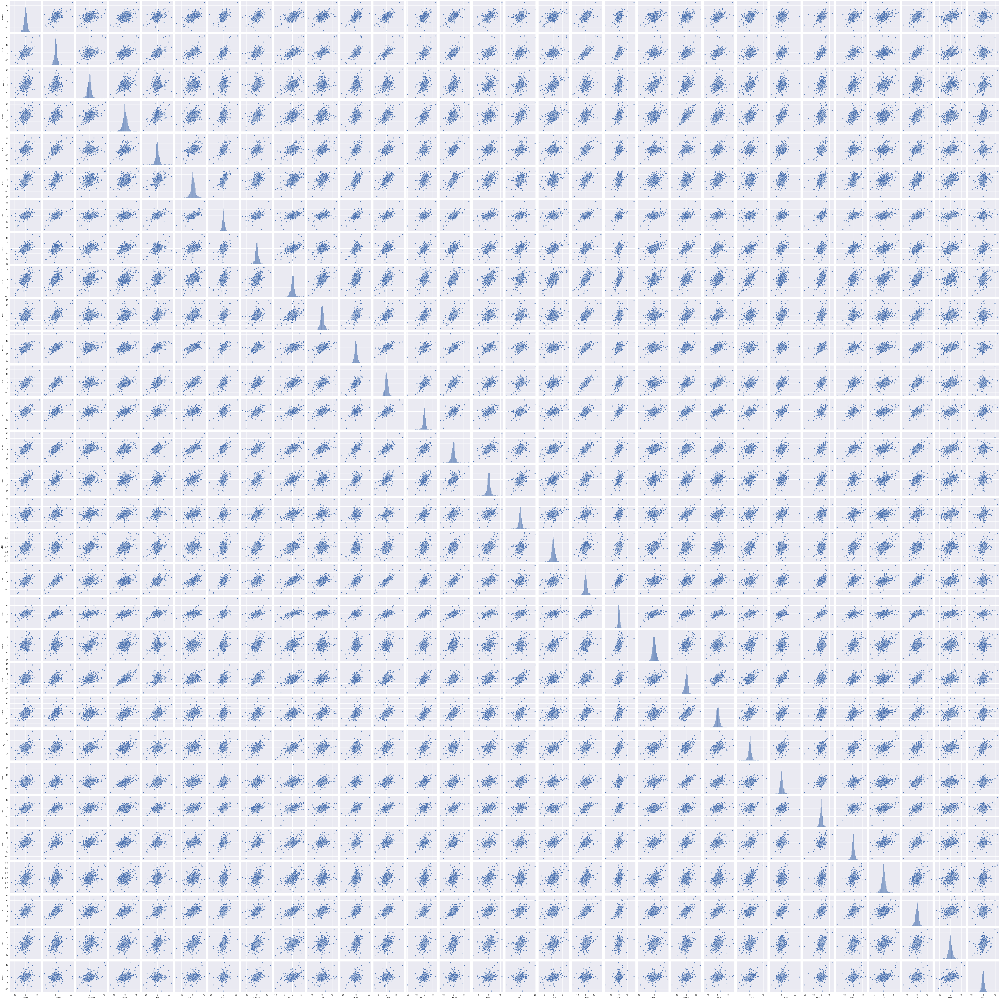

In [28]:
sns.pairplot(returns);

## 4.2 Box Plots
The box and whisker plot is a way of siplaying the distribution of data based on a five criteria (minimum, 1st Quartile (Q1), median, 3rd Quartile (Q3), and maximum). 

In [29]:

# Create a list of box plots for each column in the DataFrame
box_plots = []
for col in returns.columns:
    box_plot = go.Box(y=returns[col], name=col)
    box_plots.append(box_plot)

# Create the layout for the subplot
layout = go.Layout(
    title='Box Plots of Stock Returns',
    xaxis=dict(title='Stocks'),
    yaxis=dict(title='Returns (%)'),
    showlegend=False,
    width=1000,
    height=500
)

# Create the subplot figure
fig = go.Figure(data=box_plots, layout=layout)

# Show the plot
fig.show()

By comparing the differences in the lengths of the boxes (interquartile ranges), we can assess how spread out the data is. When two boxes do not overlap, it indicates distinctions between the two groups being compared. Specifically, we observe that all stocks do not possess this characteristic. 

Additionally, if we analyze the medians of the respective groups and find that one median line lies completely outside of another, it suggests a likely dissimilarity between these two groups. Once again, we can observe that no stocks exhibit distinct characteristics.

The whiskers on the box plot provide insights into the range between the maximum and minimum values, with wider ranges indicating more dispersed or scattered data.

Furthermore, we can use box plots to identify signs of skewness in the data, which may deviate from a normal distribution. Skewed data often result in asymmetric box plots where the median divides the box unevenly. If the longer part of the box lies above the median, we refer to it as positive skewness. Conversely, if the longer part is below or at the median, it signifies negative skewness.

Lastly, any values within the dataset that are significantly different from adjacent values are represented as separate data points on the box plot. This highlights them as potential outliers or extreme observations.

## 4.3 Distribution Plots
Distribution plots depict the variation in the data distribution. Here the distribution of returns is shown by a histogram and a line in combination with it which is the kernel density estimate. 

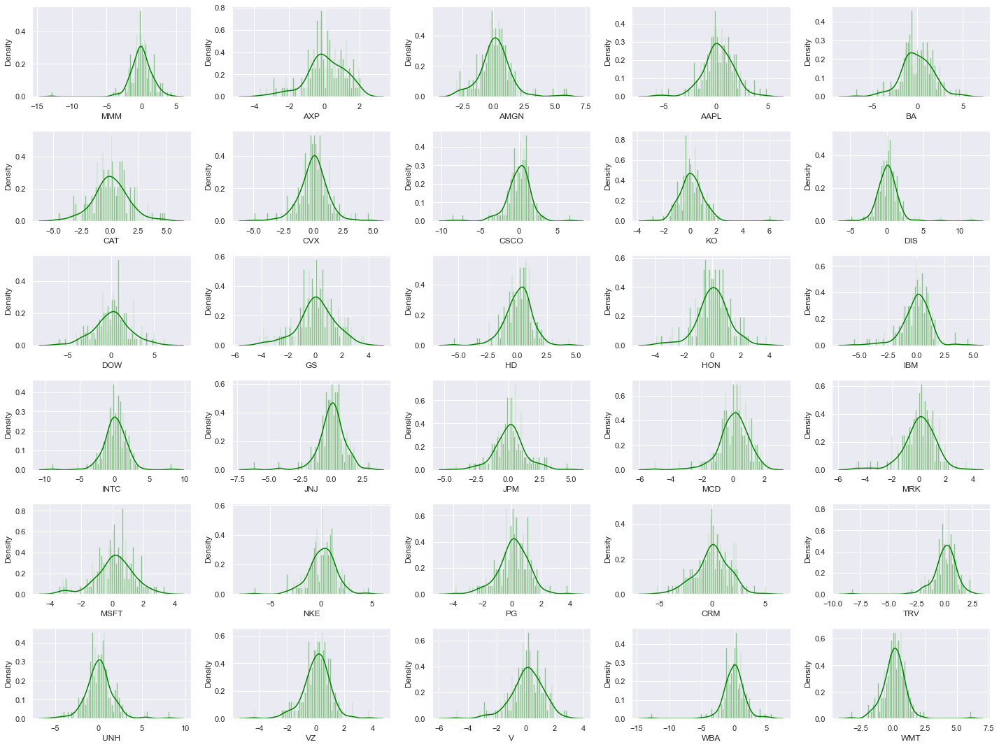

In [30]:
# Create subplots with 5 columns and 6 rows
fig, axs = plt.subplots(ncols=5, nrows=6, figsize=(20, 15))
axs = axs.flatten()

# Loop through tickers and create subplots
for index, ticker in enumerate(tickers):
    if index < len(axs):
        sns.distplot(returns.loc['2019-01-01':'2019-12-31'][ticker], color='green', bins=100, ax=axs[index])

# Remove any remaining empty subplots
for i in range(len(tickers), len(axs)):
    fig.delaxes(axs[i])

# Adjust subplot layout
plt.tight_layout()
plt.show()

## 4.4 Covariance
Covariance reflects the orientation of the linear connection between variables. It quantifies the association between the returns of two stocks, offering insights into whether these returns tend to synchronize or counteract each other.

Investors might also identify stocks that harmonize in terms of price fluctuations. Such a strategy could mitigate overall risk while enhancing the potential return of a portfolio.

In [31]:
returns.cov()

,MMM,AXP,AMGN,AAPL,BA,CAT,CVX,CSCO,KO,DIS,...,MSFT,NKE,PG,CRM,TRV,UNH,VZ,V,WBA,WMT
MMM,3.161760,2.513800,1.234332,1.764743,2.519011,2.342083,2.073538,1.863677,1.380710,1.894609,...,1.520798,1.922808,1.153489,1.428485,1.612497,1.567848,0.932943,1.779409,1.999236,0.815485
AXP,2.513800,6.710323,1.544422,2.765929,6.086491,3.442621,4.221937,2.681846,2.204660,3.896948,...,2.701083,3.161502,1.432995,2.748274,3.199211,2.712484,1.259406,3.668397,2.507622,0.904374
AMGN,1.234332,1.544422,2.797962,1.663177,1.268210,1.320505,1.333059,1.524294,1.070477,1.123598,...,1.651195,1.113134,1.240591,1.349573,1.259477,1.702072,0.893802,1.435701,1.421881,0.970935
AAPL,1.764743,2.765929,1.663177,4.758165,3.261918,1.863979,2.003901,2.508206,1.478228,2.398216,...,3.481444,2.722701,1.492125,3.331175,1.595169,2.136204,0.952824,2.657920,1.793953,1.353780
BA,2.519011,6.086491,1.268210,3.261918,12.281680,3.922364,4.810596,2.737568,2.437792,4.345578,...,2.952146,3.668036,1.350440,3.204923,3.361597,2.700574,1.249865,3.574400,2.958108,0.853857
CAT,2.342083,3.442621,1.320505,1.863979,3.922364,4.470071,3.275539,2.042921,1.488800,2.509404,...,1.749597,2.262611,1.028044,1.700422,2.140414,1.766745,1.066842,2.143992,2.330194,0.873644
CVX,2.073538,4.221937,1.333059,2.003901,4.810596,3.275539,5.964088,2.098023,1.709852,2.700665,...,1.992969,2.250091,0.960891,1.962036,2.792852,2.421427,1.136112,2.583972,2.059488,0.787241
CSCO,1.863677,2.681846,1.524294,2.508206,2.737568,2.042921,2.098023,3.667885,1.426115,2.240959,...,2.435267,2.143172,1.490996,2.264153,1.664457,1.864591,1.050268,2.171859,2.002771,1.152162
KO,1.380710,2.204660,1.070477,1.478228,2.437792,1.488800,1.709852,1.426115,2.083039,1.653402,...,1.454290,1.496587,1.357075,1.279511,1.578982,1.487067,0.989530,1.687983,1.375229,0.888182
DIS,1.894609,3.896948,1.123598,2.398216,4.345578,2.509404,2.700665,2.240959,1.653402,5.095233,...,2.422732,2.674709,1.172740,2.587130,1.918140,1.687508,0.935780,2.770746,1.900226,0.918825


## 4.5 Correlation
Correlation gauges both the intensity and orientation of the linear connection between two variables, assessing how closely they move in tandem or opposition to each other. It is derived from covariance and provides a comprehensive measure of the relationship between these variables.

In [32]:
returns.corr()

,MMM,AXP,AMGN,AAPL,BA,CAT,CVX,CSCO,KO,DIS,...,MSFT,NKE,PG,CRM,TRV,UNH,VZ,V,WBA,WMT
MMM,1.000000,0.545751,0.414998,0.454985,0.404238,0.622989,0.477502,0.547266,0.538009,0.472034,...,0.422893,0.489018,0.452826,0.311866,0.469515,0.444706,0.417857,0.515177,0.510969,0.306030
AXP,0.545751,1.000000,0.356429,0.489497,0.670450,0.628580,0.667372,0.540573,0.589687,0.666455,...,0.515573,0.551919,0.386149,0.411856,0.639420,0.528116,0.387196,0.729037,0.439931,0.232964
AMGN,0.414998,0.356429,1.000000,0.455825,0.216342,0.373389,0.326330,0.475817,0.443412,0.297583,...,0.488091,0.300940,0.517714,0.313208,0.389838,0.513205,0.425557,0.441863,0.386311,0.387330
AAPL,0.454985,0.489497,0.455825,1.000000,0.426702,0.404170,0.376170,0.600393,0.469540,0.487065,...,0.789157,0.564461,0.477494,0.592836,0.378618,0.493920,0.347880,0.627288,0.373754,0.414134
BA,0.404238,0.670450,0.216342,0.426702,1.000000,0.529373,0.562080,0.407876,0.481969,0.549334,...,0.416517,0.473324,0.268985,0.355014,0.496628,0.388652,0.284035,0.525072,0.383601,0.162580
CAT,0.622989,0.628580,0.373389,0.404170,0.529373,1.000000,0.634386,0.504530,0.487900,0.525813,...,0.409171,0.483956,0.339419,0.312217,0.524150,0.421454,0.401865,0.522049,0.500875,0.275734
CVX,0.477502,0.667372,0.326330,0.376170,0.562080,0.634386,1.000000,0.448570,0.485107,0.489910,...,0.403508,0.416660,0.274653,0.311883,0.592094,0.500073,0.370498,0.544704,0.383250,0.215104
CSCO,0.547266,0.540573,0.475817,0.600393,0.407876,0.504530,0.448570,1.000000,0.515939,0.518375,...,0.628727,0.506061,0.543439,0.458939,0.449966,0.491032,0.436746,0.583806,0.475245,0.401438
KO,0.538009,0.589687,0.443412,0.469540,0.481969,0.487900,0.485107,0.515939,1.000000,0.507514,...,0.498225,0.468929,0.656353,0.344154,0.566426,0.519656,0.546031,0.602094,0.433033,0.410644
DIS,0.472034,0.666455,0.297583,0.487065,0.549334,0.525813,0.489910,0.518375,0.507514,1.000000,...,0.530697,0.535856,0.362662,0.444932,0.439960,0.377049,0.330163,0.631916,0.382576,0.271621


In [33]:
# Create the heatmap
fig = go.Figure(data=go.Heatmap(
                   z=returns.corr(),
                   x=returns.columns,
                   y=returns.columns,
                   colorscale='YlGnBu',
                   zmax=0.8,
                   zmin=-0.8,
                   zmid=0,
                   colorbar=dict(title="Correlation"),
                   hoverongaps=False))

# Customize the layout
fig.update_layout(
    title='Correlation Between Company Returns',
    xaxis_title='Company Tickers',
    yaxis_title='Company Tickers',
    width=700,
    height=700,
    xaxis_showgrid=False,
    yaxis_showgrid=False
)

# Display the heatmap
fig.show()